# Business Understanding

Dataset ini berisikan data penjualan E-commerce dari tahun 2016-2017, detail produk yang terjual, geografi customer dan informasi pembayaran.

Pada tahun 2017-2018 mengalami penurunan peningkatan penjualan daripada tahun 2016-2017. Penurunan tersebut sampai `$751.050.560`. Oleh karena itu perusahaan ingin meningkatkan penjualan dengan membuat strategi marketing yang lebih efektif dan efisien. Sebagai tim data scientist saya akan membuat customer segmentasi berdasarkan recency, frequency dan monetary untuk membantu tim marketing u

# Import Libraries

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
customer = pd.read_csv('customers_dataset.csv')
geolocation = pd.read_csv('geolocation_dataset.csv')
order_items = pd.read_csv('order_items_dataset.csv')
order_payments = pd.read_csv('order_payments_dataset.csv')
orders = pd.read_csv('orders_dataset.csv')
product_cat_name = pd.read_csv('product_category_name_translation.csv')
products = pd.read_csv('products_dataset.csv')
sellers = pd.read_csv('sellers_dataset.csv')
order_review = pd.read_csv('order_reviews_dataset.csv')

# Exploratory Data Analysis

## Time Series Sales

In [3]:
order = orders[['order_id','order_purchase_timestamp','customer_id']].merge(order_items[['order_id','price','product_id']],how='right',on='order_id')

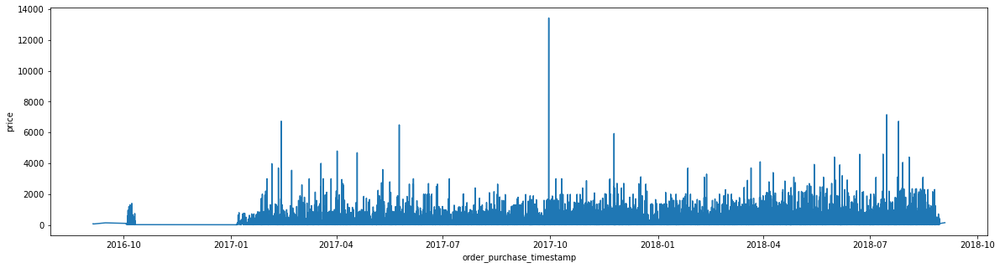

In [4]:
order['order_purchase_timestamp'] = pd.to_datetime(order['order_purchase_timestamp'])
sales = order.groupby('order_purchase_timestamp')['price'].sum().reset_index()
plt.figure(figsize=(20,5))
sns.lineplot(x='order_purchase_timestamp',y='price',data=sales)
plt.show()

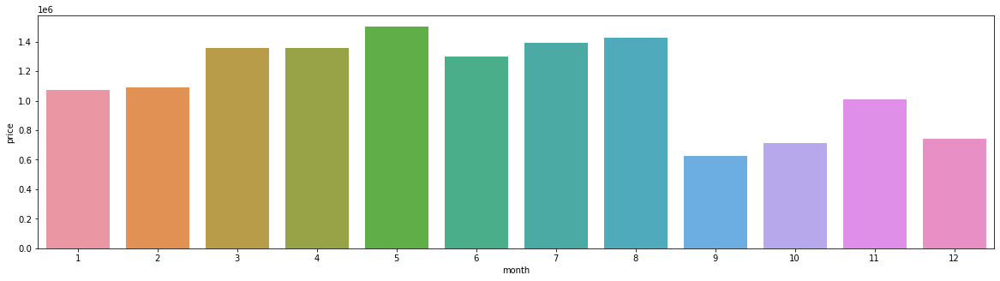

In [5]:
order['month'] = order['order_purchase_timestamp'].dt.month
sales = order.groupby('month')['price'].sum().reset_index()
plt.figure(figsize=(20,5))
sns.barplot(x='month',y='price',data=sales)
plt.show()

**Data Insight**

    1. Penjualan terbanyak : Mei
    2. Penjualan terkecil : September

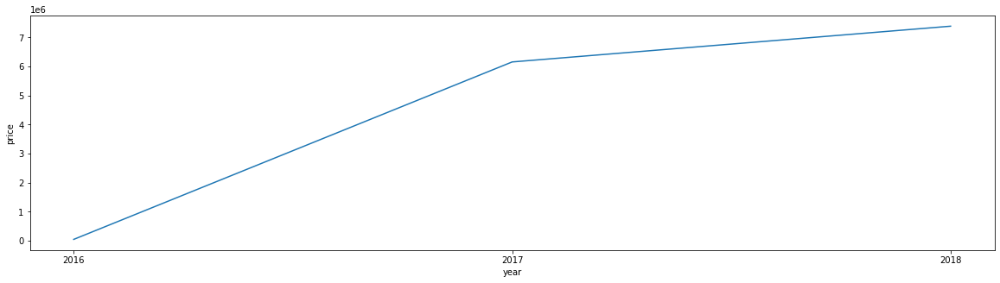

In [6]:
import datetime as dt
order['year'] = order['order_purchase_timestamp'].dt.year
sales = order.groupby('year')['price'].sum().reset_index()
plt.figure(figsize=(20,5))
sns.lineplot(x='year',y='price',data=sales)
plt.xticks([2016,2017,2018])
plt.show()

In [7]:
sales_2017 = np.array(sales[sales['year']==2017]['price'])
sales_2016 = np.array(sales[sales['year']==2016]['price'])
sales_2017_2016 = sales_2017-sales_2016

In [8]:
sales_2018 = np.array(sales[sales['year']==2018]['price'])
sales_2018_2017 = sales_2018-sales_2017

In [9]:
sales_2018_2017 - sales_2017_2016

array([-4875777.24])

In [10]:
order['month-year'] = order['order_purchase_timestamp'].dt.strftime('%m-%y')

In [11]:
xticks = ['09-16','10-16','12-16','01-17','02-17','03-17','04-17',
'05-17','06-17','07-17','08-17','09-17','10-17','11-17','12-17',
'01-18','02-18','03-18','04-18','05-18','06-18','07-18','08-18']

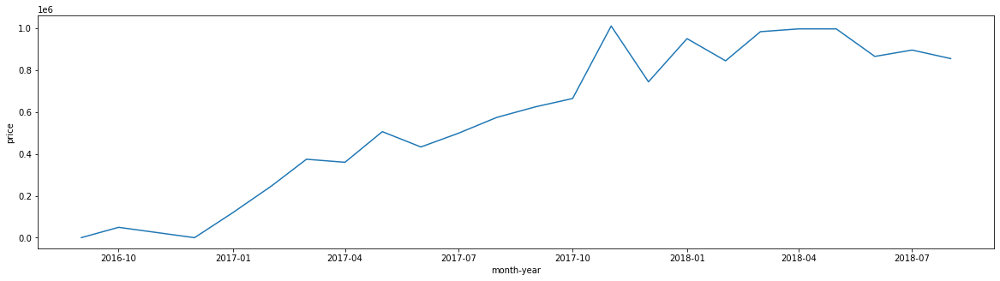

In [12]:
months = order.groupby('month-year')['price'].sum().reset_index()
month = pd.DataFrame({'month-year':xticks})
month = month.merge(months,how='left',on='month-year')
month['month-year'] = pd.to_datetime(month['month-year'],format='%m-%y')
plt.figure(figsize=(20,5))
sns.lineplot(x='month-year',y='price',data=month)
plt.show()

**Data Insight**

    1. Penjualan meningkat signifikan dari tahun 2016-2017
    2. Peningkatan penjualan mulai stagnan ketika sudah masuk pada tahun 2018

## Forecasting Analysis

In [13]:
from prophet import Prophet

In [14]:
order['date'] = pd.to_datetime(order['order_purchase_timestamp'])
order['date'] = order['date'].dt.strftime('%d-%m-%Y')
sales = order.groupby('date')['price'].sum().reset_index()
sales['date'] = pd.to_datetime(sales['date'],format='%d-%m-%Y')

In [15]:
y = sales
y.columns = ['ds', 'y']
train = y
m = Prophet()
m.fit(train)

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


In [16]:
test = pd.read_csv('test.csv')
test['ds'] = pd.to_datetime(test['ds'] )

In [17]:
future = m.make_future_dataframe(periods=len(test))

In [18]:
forecast = m.predict(future)

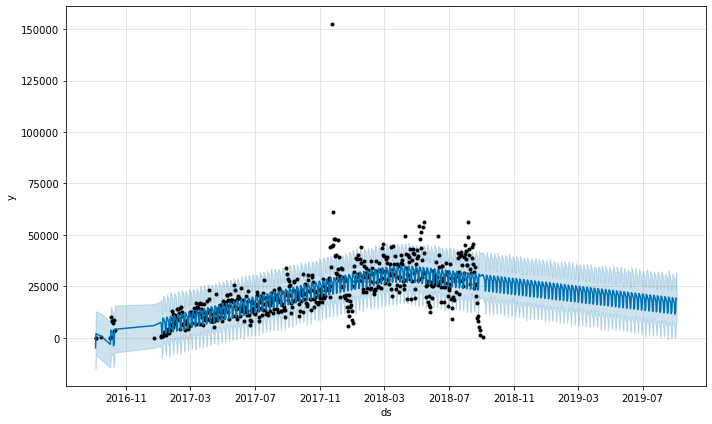

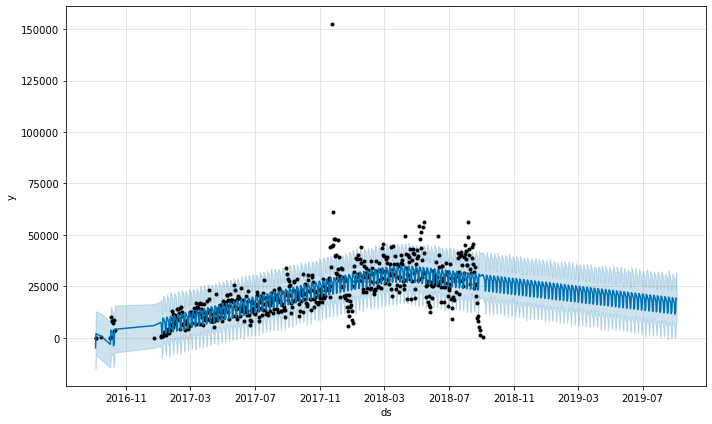

In [19]:
m.plot(forecast)

Penjualan pada tahun 2019 diprediksi menurun berdasarkan forecasting yang dilakukan oleh karena itu dibutuhkan strategi marketing yang tepat untuk mengantisipasi hal tersebut

## Category

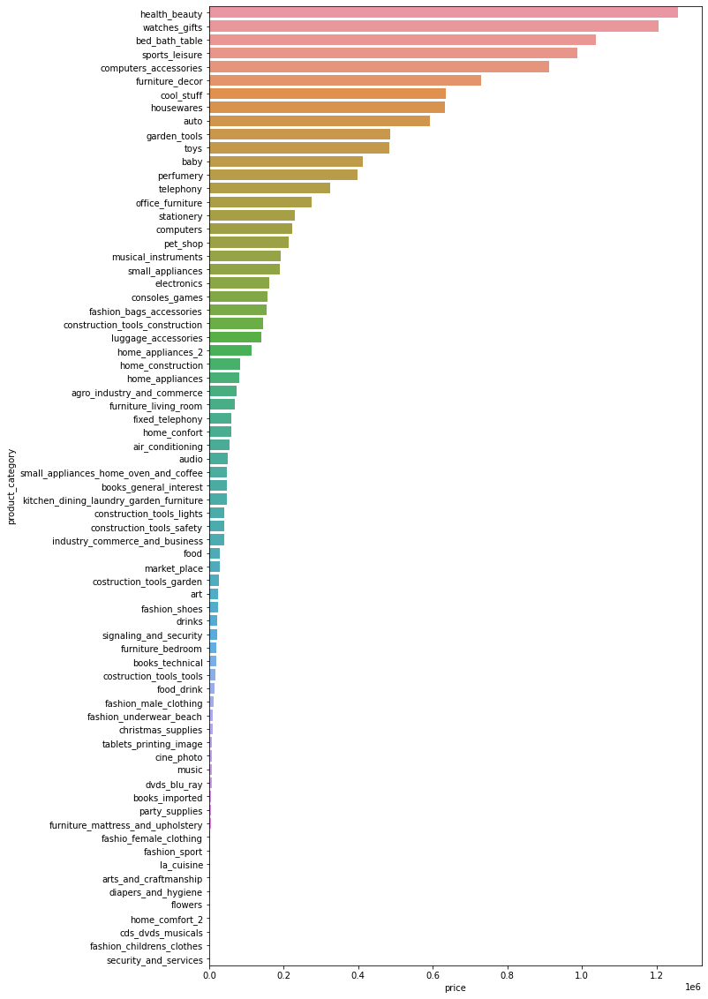

In [20]:
order = order.merge(products[['product_id','product_category_name']],how='left',on='product_id')
order = order.merge(product_cat_name[['product_category_name_english','product_category_name']],how='left',on='product_category_name')
order.drop('product_category_name',axis=1,inplace=True)
order['product_category'] = order['product_category_name_english']
order.drop(['product_category_name_english'],axis=1,inplace=True)
category = order.groupby('product_category')['price'].sum().reset_index().sort_values('price',ascending=False)
plt.figure(figsize=(10,20))
sns.barplot(y='product_category',x='price',data=category)
plt.show()

kategori sales dibawah ini sudah melebihi `$1.000.000` :
    
    1. health beauty
    2. watches_gift
    3. bed bath table

## State

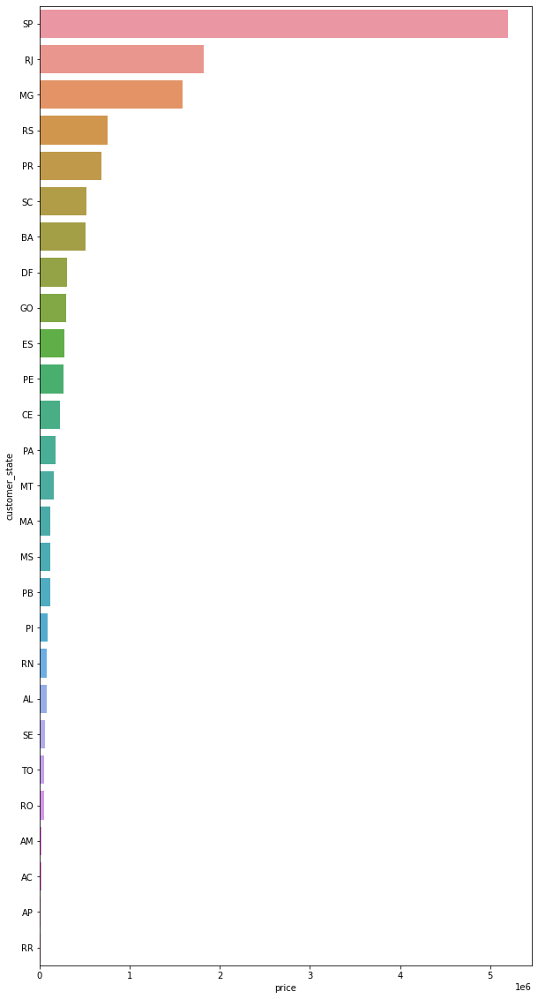

In [21]:
order = order.merge(customer,how='left',on='customer_id')
state = order.groupby('customer_state')['price'].sum().reset_index().sort_values('price',ascending=False)
plt.figure(figsize=(10,20))
sns.barplot(y='customer_state',x='price',data=state)
plt.show()

In [22]:
state

,customer_state,price
25,SP,5202955.05
18,RJ,1824092.67
10,MG,1585308.03
22,RS,750304.02
17,PR,683083.76
23,SC,520553.34
4,BA,511349.99
6,DF,302603.94
8,GO,294591.95
7,ES,275037.31


Regional Sao Paolo mendominasi total penjualan dengan nilai `$5.000.000`

In [23]:
import folium

In [24]:
location =geolocation.groupby('geolocation_zip_code_prefix').agg({'geolocation_lat':'mean',
                                                       'geolocation_lng':'mean'}).reset_index()

In [25]:
order = order.merge(location,how='left',right_on = 'geolocation_zip_code_prefix',left_on='customer_zip_code_prefix')

In [26]:
order

,order_id,order_purchase_timestamp,customer_id,price,product_id,month,year,month-year,date,product_category,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,geolocation_zip_code_prefix,geolocation_lat,geolocation_lng
0,00010242fe8c5a6d1ba2dd792cb16214,2017-09-13 08:59:02,3ce436f183e68e07877b285a838db11a,58.90,4244733e06e7ecb4970a6e2683c13e61,9,2017,09-17,13-09-2017,cool_stuff,871766c5855e863f6eccc05f988b23cb,28013,campos dos goytacazes,RJ,28013.0,-21.762775,-41.309633
1,00018f77f2f0320c557190d7a144bdd3,2017-04-26 10:53:06,f6dd3ec061db4e3987629fe6b26e5cce,239.90,e5f2d52b802189ee658865ca93d83a8f,4,2017,04-17,26-04-2017,pet_shop,eb28e67c4c0b83846050ddfb8a35d051,15775,santa fe do sul,SP,15775.0,-20.220527,-50.903424
2,000229ec398224ef6ca0657da4fc703e,2018-01-14 14:33:31,6489ae5e4333f3693df5ad4372dab6d3,199.00,c777355d18b72b67abbeef9df44fd0fd,1,2018,01-18,14-01-2018,furniture_decor,3818d81c6709e39d06b2738a8d3a2474,35661,para de minas,MG,35661.0,-19.870305,-44.593326
3,00024acbcdf0a6daa1e931b038114c75,2018-08-08 10:00:35,d4eb9395c8c0431ee92fce09860c5a06,12.99,7634da152a4610f1595efa32f14722fc,8,2018,08-18,08-08-2018,perfumery,af861d436cfc08b2c2ddefd0ba074622,12952,atibaia,SP,12952.0,-23.089925,-46.611654
4,00042b26cf59d7ce69dfabb4e55b4fd9,2017-02-04 13:57:51,58dbd0b2d70206bf40e62cd34e84d795,199.90,ac6c3623068f30de03045865e4e10089,2,2017,02-17,04-02-2017,garden_tools,64b576fb70d441e8f1b2d7d446e483c5,13226,varzea paulista,SP,13226.0,-23.243402,-46.827614
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
112645,fffc94f6ce00a00581880bf54a75a037,2018-04-23 13:57:06,b51593916b4b8e0d6f66f2ae24f2673d,299.99,4aa6014eceb682077f9dc4bffebc05b0,4,2018,04-18,23-04-2018,housewares,0c9aeda10a71f369396d0c04dce13a64,65077,sao luis,MA,65077.0,-2.497993,-44.297761
112646,fffcd46ef2263f404302a634eb57f7eb,2018-07-14 10:26:46,84c5d4fbaf120aae381fad077416eaa0,350.00,32e07fd915822b0765e448c4dd74c828,7,2018,07-18,14-07-2018,computers_accessories,0da9fe112eae0c74d3ba1fe16de0988b,81690,curitiba,PR,81690.0,-25.566904,-49.309115
112647,fffce4705a9662cd70adb13d4a31832d,2017-10-23 17:07:56,29309aa813182aaddc9b259e31b870e6,99.90,72a30483855e2eafc67aee5dc2560482,10,2017,10-17,23-10-2017,sports_leisure,cd79b407828f02fdbba457111c38e4c4,4039,sao paulo,SP,4039.0,-23.597794,-46.643923
112648,fffe18544ffabc95dfada21779c9644f,2017-08-14 23:02:59,b5e6afd5a41800fdf401e0272ca74655,55.99,9c422a519119dcad7575db5af1ba540e,8,2017,08-17,14-08-2017,computers_accessories,eb803377c9315b564bdedad672039306,13289,vinhedo,SP,13289.0,-23.040252,-46.979782


## Payments

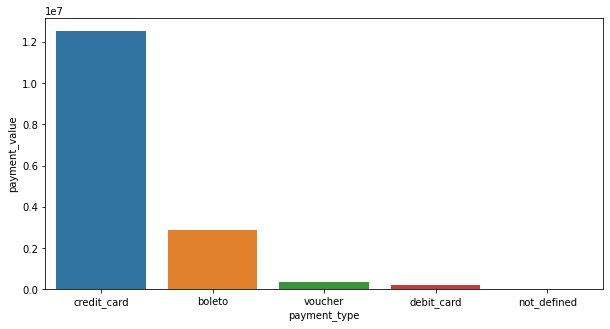

In [27]:
payment = order_payments.groupby('payment_type')['payment_value'].sum().reset_index().sort_values('payment_value',ascending=False)
plt.figure(figsize=(10,5))
sns.barplot(x='payment_type',y='payment_value',data=payment)
plt.show()

credit card metode pembayaran paling banyak digunakan dengan nilai transaksi sebesar `$ 12.000.000`

## Review

<AxesSubplot:xlabel='review_score', ylabel='order_id'>

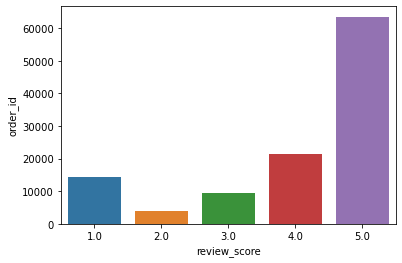

In [28]:
order = order.merge(order_review[['order_id','review_score']],how='left',on='order_id')
rating = order.groupby('review_score')['order_id'].count().reset_index()
sns.barplot(x='review_score',y='order_id',data=rating)

# Create Table Aggregate

## Join Required Table

In [29]:
import warnings
warnings.filterwarnings("ignore")

In [30]:
agg_table = orders[['order_id','order_purchase_timestamp','customer_id']].merge(order_items[['order_id','price','product_id','freight_value','order_item_id']],how='right',on='order_id')

In [31]:
agg_table = agg_table.merge(products[['product_id','product_category_name']],how='left',on='product_id')

In [32]:
agg_table = agg_table.merge(product_cat_name,how='left',on='product_category_name')

In [33]:
agg_table = agg_table.merge(customer,how='left',on='customer_id')

In [34]:
agg_table = agg_table.merge(order_payments[['payment_type','payment_installments','payment_value','order_id']],how='left',on='order_id')

In [35]:
agg_table.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 117604 entries, 0 to 117603
Data columns (total 16 columns):
 #   Column                         Non-Null Count   Dtype  
---  ------                         --------------   -----  
 0   order_id                       117604 non-null  object 
 1   order_purchase_timestamp       117604 non-null  object 
 2   customer_id                    117604 non-null  object 
 3   price                          117604 non-null  float64
 4   product_id                     117604 non-null  object 
 5   freight_value                  117604 non-null  float64
 6   order_item_id                  117604 non-null  int64  
 7   product_category_name          115906 non-null  object 
 8   product_category_name_english  115881 non-null  object 
 9   customer_unique_id             117604 non-null  object 
 10  customer_zip_code_prefix       117604 non-null  int64  
 11  customer_city                  117604 non-null  object 
 12  customer_state                

In [36]:
agg_table.columns

Index(['order_id', 'order_purchase_timestamp', 'customer_id', 'price',
       'product_id', 'freight_value', 'order_item_id', 'product_category_name',
       'product_category_name_english', 'customer_unique_id',
       'customer_zip_code_prefix', 'customer_city', 'customer_state',
       'payment_type', 'payment_installments', 'payment_value'],
      dtype='object')

## Determine Unique Key for Customer

In [37]:
agg_table.groupby('customer_id')['customer_unique_id'].nunique().reset_index().sort_values('customer_unique_id',ascending=False)

,customer_id,customer_unique_id
0,00012a2ce6f8dcda20d059ce98491703,1
65713,aa33d697a2f5ee04aae5e9a8227e913e,1
65783,aa5f8aa4c21fe89a04e8d221d4cd8ac1,1
65782,aa5f87b79875f43b90b310decb62356e,1
65781,aa5f5931b8901ae1ca4b8302f9b94c02,1
...,...,...
32886,5582a1c42a6723f0fdbb6dccb54693ae,1
32885,5581f26ba2dcb90e8c250e0850c66172,1
32884,55814b1c0dcf038f760c8f30b1b1d430,1
32883,5581302de852c09823ec2e0fd3c46d82,1


In [38]:
agg_table.groupby('customer_unique_id')['customer_id'].nunique().reset_index().sort_values('customer_id',ascending=False)

,customer_unique_id,customer_id
52597,8d50f5eadf50201ccdcedfb9e2ac8455,16
23302,3e43e6105506432c953e165fb2acf44c,9
10281,1b6c7548a2a1f9037c1fd3ddfed95f33,7
37532,6469f99c1f9dfae7733b25662e7f1782,7
75560,ca77025e7201e3b30c44b472ff346268,7
...,...,...
32272,5657f9f721c16800a66c21081d46b18d,1
32271,5657dfebff5868c4dc7e8355fea865c4,1
32270,5657596addb4d7b07b32cd330614bdf8,1
32269,5656eb169546146caeab56c3ffc3d268,1


customer_unique_id is choosen to be unique key for customer 

In [39]:
agg_table.drop('customer_id',axis=1,inplace=True)

# Feature Engineering

## Recency

In [40]:
agg_table['order_purchase_timestamp'] = pd.to_datetime(agg_table['order_purchase_timestamp'])

In [41]:
max_date = max(agg_table['order_purchase_timestamp'])
max_date

Timestamp('2018-09-03 09:06:57')

In [42]:
agg_table['recency'] = agg_table['order_purchase_timestamp'].apply(lambda x:(max_date-x).days)

In [43]:
agg_table['recency'].value_counts()

282    1321
283     543
281     542
280     487
279     475
       ... 
728       3
717       3
0         1
700       1
618       1
Name: recency, Length: 615, dtype: int64

In [44]:
recency = agg_table.groupby('customer_unique_id')['recency'].min().reset_index()

In [45]:
agg_table.drop('recency',axis=1,inplace=True)
agg_table = agg_table.merge(recency,how='left',on='customer_unique_id')
agg_table

,order_id,order_purchase_timestamp,price,product_id,freight_value,order_item_id,product_category_name,product_category_name_english,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,payment_type,payment_installments,payment_value,recency
0,00010242fe8c5a6d1ba2dd792cb16214,2017-09-13 08:59:02,58.90,4244733e06e7ecb4970a6e2683c13e61,13.29,1,cool_stuff,cool_stuff,871766c5855e863f6eccc05f988b23cb,28013,campos dos goytacazes,RJ,credit_card,2.0,72.19,355
1,00018f77f2f0320c557190d7a144bdd3,2017-04-26 10:53:06,239.90,e5f2d52b802189ee658865ca93d83a8f,19.93,1,pet_shop,pet_shop,eb28e67c4c0b83846050ddfb8a35d051,15775,santa fe do sul,SP,credit_card,3.0,259.83,349
2,000229ec398224ef6ca0657da4fc703e,2018-01-14 14:33:31,199.00,c777355d18b72b67abbeef9df44fd0fd,17.87,1,moveis_decoracao,furniture_decor,3818d81c6709e39d06b2738a8d3a2474,35661,para de minas,MG,credit_card,5.0,216.87,231
3,00024acbcdf0a6daa1e931b038114c75,2018-08-08 10:00:35,12.99,7634da152a4610f1595efa32f14722fc,12.79,1,perfumaria,perfumery,af861d436cfc08b2c2ddefd0ba074622,12952,atibaia,SP,credit_card,2.0,25.78,25
4,00042b26cf59d7ce69dfabb4e55b4fd9,2017-02-04 13:57:51,199.90,ac6c3623068f30de03045865e4e10089,18.14,1,ferramentas_jardim,garden_tools,64b576fb70d441e8f1b2d7d446e483c5,13226,varzea paulista,SP,credit_card,3.0,218.04,575
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
117599,fffc94f6ce00a00581880bf54a75a037,2018-04-23 13:57:06,299.99,4aa6014eceb682077f9dc4bffebc05b0,43.41,1,utilidades_domesticas,housewares,0c9aeda10a71f369396d0c04dce13a64,65077,sao luis,MA,boleto,1.0,343.40,132
117600,fffcd46ef2263f404302a634eb57f7eb,2018-07-14 10:26:46,350.00,32e07fd915822b0765e448c4dd74c828,36.53,1,informatica_acessorios,computers_accessories,0da9fe112eae0c74d3ba1fe16de0988b,81690,curitiba,PR,boleto,1.0,386.53,50
117601,fffce4705a9662cd70adb13d4a31832d,2017-10-23 17:07:56,99.90,72a30483855e2eafc67aee5dc2560482,16.95,1,esporte_lazer,sports_leisure,cd79b407828f02fdbba457111c38e4c4,4039,sao paulo,SP,credit_card,3.0,116.85,314
117602,fffe18544ffabc95dfada21779c9644f,2017-08-14 23:02:59,55.99,9c422a519119dcad7575db5af1ba540e,8.72,1,informatica_acessorios,computers_accessories,eb803377c9315b564bdedad672039306,13289,vinhedo,SP,credit_card,3.0,64.71,384


## Frequency

In [46]:
frequency = agg_table.groupby('customer_unique_id')['order_id'].count().reset_index().sort_values('order_id',ascending=False)
frequency['frequency'] = frequency['order_id']
frequency.drop('order_id',axis=1,inplace=True)

In [47]:
agg_table = agg_table.merge(frequency,how='left',on='customer_unique_id')

## Monetary

In [48]:
monetary = agg_table.groupby('customer_unique_id')['payment_value'].sum().reset_index().sort_values('payment_value',ascending=False)
monetary['monetary'] = monetary['payment_value']
monetary.drop('payment_value',axis=1,inplace=True)

In [49]:
agg_table = agg_table.merge(monetary,how='left',on='customer_unique_id')

# Exploratory Data Analysis

In [50]:
model_table = agg_table[['customer_unique_id','recency','frequency','monetary']]

## Univariate Analysis

In [51]:
columns = ['recency','frequency','monetary']
model_table[columns].describe()

,recency,frequency,monetary
count,117604.000000,117604.000000,117604.000000
mean,242.990944,1.782150,376.087135
std,153.134516,2.783451,1654.804020
min,0.000000,1.000000,0.000000
25%,119.000000,1.000000,70.150000
50%,223.000000,1.000000,133.815000
75%,352.000000,2.000000,278.195000
max,728.000000,75.000000,109312.640000


Banyak dari customer yang memiliki frequency 1 dilihat dari rata-rata dan persebaran 75% percentile nya adalah 1

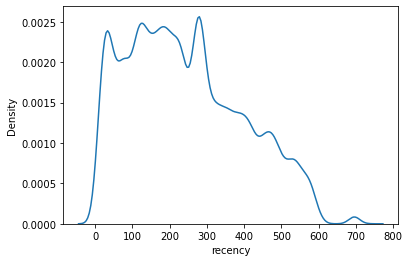

<Figure size 216x216 with 0 Axes>

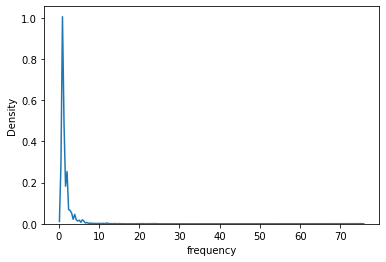

<Figure size 216x216 with 0 Axes>

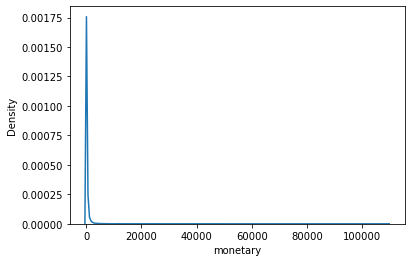

<Figure size 216x216 with 0 Axes>

In [52]:
columns = ['recency','frequency','monetary']
for j in range (0,len(columns)):
    col = columns[j]
    sns.kdeplot(x=model_table[col])
    plt.figure(figsize=(3,3))
    plt.show()

frequency dan monetary memiliki nilai skew positive eksrim

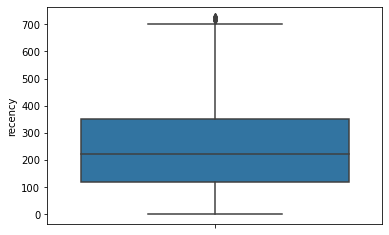

<Figure size 216x216 with 0 Axes>

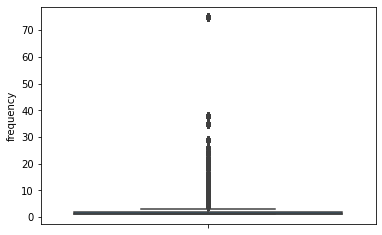

<Figure size 216x216 with 0 Axes>

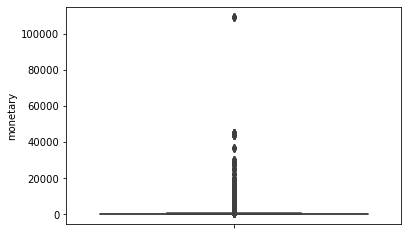

<Figure size 216x216 with 0 Axes>

In [53]:
columns = ['recency','frequency','monetary']
for j in range (0,len(columns)):
    col = columns[j]
    sns.boxplot(y=model_table[col])
    plt.figure(figsize=(3,3))
    plt.show()

frequency dan monetary memiliki ekstrim outlier

## Multivariate Analysis

<AxesSubplot:>

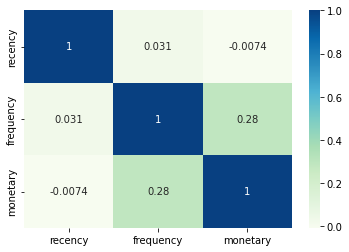

In [54]:
df_corr = model_table[columns]
correlation = df_corr.corr()
sns.heatmap(correlation, cmap = "GnBu", annot = True)

feature don't have correlation each others

# Data Preprocessing

## Handling Duplicated Value

In [55]:
model_table.shape[0]

117604

In [56]:
model_table.duplicated().sum()

22184

In [57]:
model_table.duplicated(subset='customer_unique_id').sum()

22184

In [58]:
model_table[model_table.duplicated(subset='customer_unique_id')]

,customer_unique_id,recency,frequency,monetary
14,9e4159995424971423b98c4a8bc11529,201,2,253.08
33,bb8a37225e0279ac8a274c9765617eaf,321,3,327.87
34,bb8a37225e0279ac8a274c9765617eaf,321,3,327.87
39,33febb33a42a35f5826a22584b127f9d,492,2,70.55
44,d1f24d1d504e27bee13b415e40daeab0,250,3,382.68
...,...,...,...,...
117584,2b19910e856b2ba3e7257e63a093a3df,341,2,262.96
117589,028c09f007292c4e3a3b10d296e47987,169,2,912.56
117595,f736308cd9952b33b90b9fe94da9c8f5,310,4,1427.04
117596,f736308cd9952b33b90b9fe94da9c8f5,310,4,1427.04


data with duplicated value can be dropped

In [59]:
model_table.drop_duplicates(inplace=True)

In [60]:
model_table.shape[0]

95420

## Handling Missing Value

In [61]:
def preprocessing(df):
    """"
    Objective :
    Function for preprocessing data, known missing, duplicated values and basic stastics every column in dataframe and duplicated row
    df is dataframe
    """
    try:
        import pandas as pd
        variables = pd.DataFrame(columns=['Variable','Number of unique values','Percent of Null(%)','Number of Null','Type','Values'])
        for i, var in enumerate(df.columns):
            variables.loc[i] = [var, df[var].nunique(),df[var].isnull().sum()/df.shape[0]*100,df[var].isnull().sum(),df[var].dtypes,df[var].unique()]
        return (variables.set_index('Variable'))
    except:
        print('ada kesalahan penginputan')

In [62]:
preprocessing(model_table)

,Number of unique values,Percent of Null(%),Number of Null,Type,Values
Variable,,,,,
customer_unique_id,95420,0.0,0,object,"[871766c5855e863f6eccc05f988b23cb, eb28e67c4c0..."
recency,614,0.0,0,int64,"[355, 349, 231, 25, 575, 475, 266, 60, 167, 62..."
frequency,27,0.0,0,int64,"[1, 2, 3, 4, 5, 7, 6, 24, 8, 10, 9, 11, 14, 16..."
monetary,30850,0.0,0,float64,"[72.19, 284.56, 216.87, 25.78, 218.04, 34.59, ..."


feature don't have null values

## Handling Outlier

In [63]:
columns

['recency', 'frequency', 'monetary']

In [64]:
Q1 = model_table['frequency'].quantile(0.25)
Q3 = model_table['frequency'].quantile(0.75)
IQR = Q3-Q1
low_limit = Q1 - (1.5*IQR)
high_limit = Q3 + (1.5*IQR)
filtered_entries = ((model_table['frequency']>=low_limit)&(model_table['frequency']<=high_limit))
df_clean_IQR = model_table
df_clean_IQR = df_clean_IQR[filtered_entries]
df_clean_IQR.shape[0]

81088

In [65]:
Q1 = model_table['frequency'].quantile(0.25)
Q3 = model_table['frequency'].quantile(0.75)
IQR = Q3-Q1
low_limit = Q1 - (1.5*IQR)
high_limit = Q3 + (1.5*IQR)

In [66]:
high_limit

1.0

In [67]:
from scipy import stats
zscore = abs(stats.zscore(model_table['frequency']))
filtered_entries = (zscore < 3)
model_table[filtered_entries]['frequency'].describe()

count    93682.000000
mean         1.155163
std          0.415390
min          1.000000
25%          1.000000
50%          1.000000
75%          1.000000
max          3.000000
Name: frequency, dtype: float64

In [68]:
Q1 = df_clean_IQR['monetary'].quantile(0.25)
Q3 = df_clean_IQR['monetary'].quantile(0.75)
IQR = Q3-Q1
low_limit = Q1 - (1.5*IQR)
high_limit = Q3 + (1.5*IQR)
filtered_entries = ((df_clean_IQR['monetary']>=low_limit)&(df_clean_IQR['monetary']<=high_limit))
df_clean_IQR = df_clean_IQR[filtered_entries]
df_clean_IQR.shape[0]

74908

In [69]:
outlier_data = (1-(df_clean_IQR.shape[0]/model_table.shape[0]))*100 
print('percentage of outlier data',outlier_data,'%')

percentage of outlier data 21.496541605533427 %


In [70]:
df_clean_IQR['frequency'].value_counts()

1    74908
Name: frequency, dtype: int64

In [71]:
df_clean_IQR['monetary'].value_counts()

77.57     238
35.00     151
73.34     144
116.94    124
99.90     106
         ... 
100.37      1
62.73       1
65.21       1
98.47       1
273.92      1
Name: monetary, Length: 18182, dtype: int64

Handling outlier decrease significantly variety of data

# Customer Segmentation

## RFM scoring

In [72]:
rfm = model_table

In [73]:
bins_recency = [0,np.quantile(rfm['recency'],.33),np.quantile(rfm['recency'],.66),np.quantile(rfm['recency'],1)]
bins_frequency = [0,np.quantile(rfm['frequency'],.33),np.quantile(rfm['frequency'],1)]
bins_monetary = [0,np.quantile(rfm['monetary'],.33),np.quantile(rfm['monetary'],.66),np.quantile(rfm['monetary'],1)]

In [74]:
rfm['recency_score']    = pd.cut(rfm['recency'], bins_recency, labels=[3, 2, 1], include_lowest=True)
rfm['frequency_score']  = pd.cut(rfm['frequency'], bins_frequency, labels=[1, 2], include_lowest=True)
rfm['monetary_score']   = pd.cut(rfm['monetary'], bins_monetary, labels=[1, 2, 3], include_lowest=True)

In [75]:
rfm['recency_score']    = rfm.recency_score.astype(int)
rfm['frequency_score']  = rfm.frequency_score.astype(int)
rfm['monetary_score']   = rfm.monetary_score.astype(int)
rfm['rfm_score'] = rfm['recency_score'].map(str) + rfm['frequency_score'].map(str) + rfm['monetary_score'].map(str)

In [76]:
rfm['rfm_score'] = rfm['rfm_score'].astype(int)

In [77]:
segment_customer = pd.read_csv('segment_customer.csv')

In [78]:
rfm = rfm.merge(segment_customer,how='left',on='rfm_score')

### Result and Insight

In [79]:
rfm.groupby('category').agg({'recency':['mean','min','max'],'frequency':['mean','min','max']
                             ,'monetary':['mean','min','max','count']
})

recency           frequency            monetary  \
                                mean  min  max      mean min max        mean   
category                                                                       
AVERAGE CUSTOMER          224.425431  153  291  1.054026   1  22  111.280503   
LOST CUSTOMER             422.096976  292  728  1.000000   1   1   50.461594   
LOYAL CUSTOMER            144.687665    0  291  2.580698   2  24  648.676877   
POTENTIAL LOYAL CUSTOMER  238.518659    5  698  1.293889   1  19  276.060294   
POTENTIAL RISK CUSTOMER   355.885815  153  728  1.205231   1  75  218.642856   
RECENT CUSTOMER            79.307590    4  152  1.000000   1   1  155.318546   

                                                   
                            min        max  count  
category                                           
AVERAGE CUSTOMER          16.37     161.37   9736  
LOST CUSTOMER             10.07      76.46  10384  
LOYAL CUSTOMER            77.00   44048.00   7937  
POTENTIAL LOYAL CUSTOMER   9.59    4175.26   9245  
POTENTIAL RISK CUSTOMER    0.00  109312.64  31160  
RECENT CUSTOMER           10.89    6922.21  26958

**Business Recommendation**

    1. LOYAL CUSTOMER : best customer who bought most often, recently and heavy spenders. They can be early adopters for new products and will help our products
    2. POTENTIAL LOYAL CUSTOMER : recent customer with higher frequency and spent good amount

# Kmeans Modeling 

### RFM

In [80]:
rfm_df = rfm[columns]

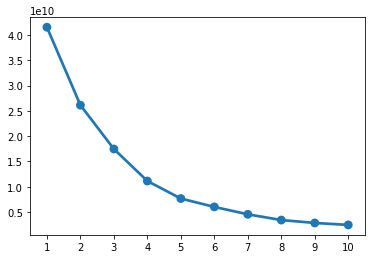

In [81]:
from sklearn.cluster import KMeans
SSE = []
for k in range(0,10):
    kmeans = KMeans(n_clusters=k+1,random_state=43).fit(rfm_df)
    SSE.append(kmeans.inertia_)
sns.pointplot(x=list(range(1,11)),y=SSE)
plt.show()

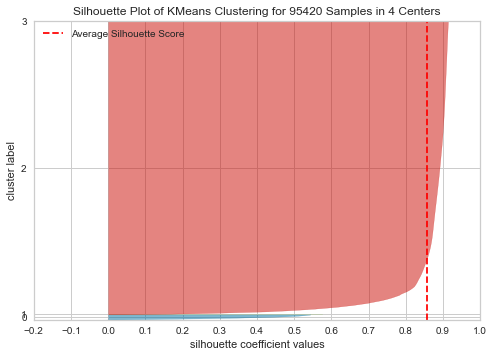

SilhouetteVisualizer(ax=<AxesSubplot:title={'center':'Silhouette Plot of KMeans Clustering for 95420 Samples in 4 Centers'}, xlabel='silhouette coefficient values', ylabel='cluster label'>,
                     colors='yellowbrick',
                     estimator=KMeans(n_clusters=4, random_state=43))

In [82]:
from yellowbrick.cluster import silhouette_visualizer
silhouette_visualizer(KMeans(4, random_state=43), rfm_df, colors='yellowbrick')

not good clustering

### RFM Score

In [83]:
rfm.iloc[:,4:7]

,recency_score,frequency_score,monetary_score
0,1,1,1
1,1,2,3
2,2,1,3
3,3,1,1
4,1,1,3
...,...,...,...
95415,3,1,3
95416,3,1,3
95417,1,1,2
95418,1,1,1


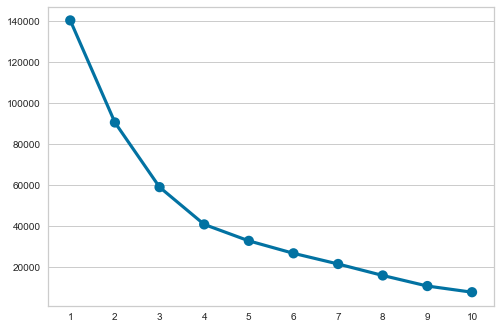

In [84]:
from sklearn.cluster import KMeans
SSE = []
for k in range(0,10):
    kmeans = KMeans(n_clusters=k+1,random_state=43).fit(rfm.iloc[:,4:7])
    SSE.append(kmeans.inertia_)
sns.pointplot(x=list(range(1,11)),y=SSE)
plt.show()

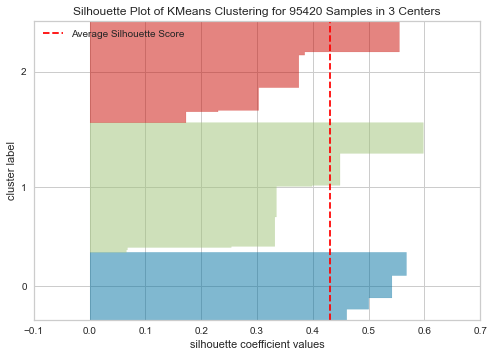

SilhouetteVisualizer(ax=<AxesSubplot:title={'center':'Silhouette Plot of KMeans Clustering for 95420 Samples in 3 Centers'}, xlabel='silhouette coefficient values', ylabel='cluster label'>,
                     colors='yellowbrick',
                     estimator=KMeans(n_clusters=3, random_state=43))

In [85]:
from yellowbrick.cluster import silhouette_visualizer
silhouette_visualizer(KMeans(3, random_state=43), rfm.iloc[:,4:7], colors='yellowbrick')

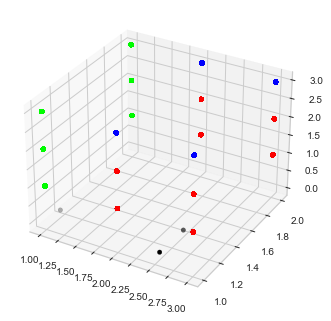

In [86]:
model = KMeans(n_clusters=3,random_state=43).fit(rfm.iloc[:,4:7])
centers = model.cluster_centers_
fig = plt.figure()
ax = fig.add_subplot(111,projection='3d')
ax.scatter(rfm['recency_score'],rfm['frequency_score'],rfm['monetary_score'],
           c=model.predict(rfm.iloc[:,4:7]),cmap='brg')
ax.scatter(centers[:,0],centers[:,1],c='black')

# Result and Insight

## Distribusi Cluster berdasarkan RFM Score

<function matplotlib.pyplot.legend(*args, **kwargs)>

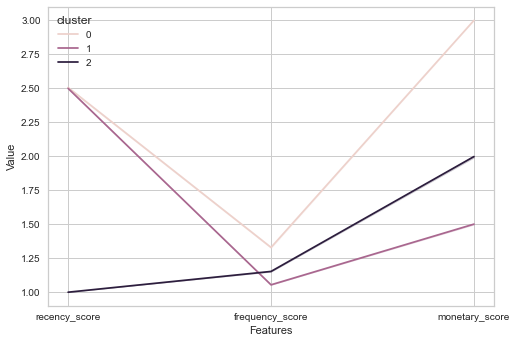

In [87]:
rfm['cluster'] = model.labels_
melted_rfm = pd.melt(rfm.reset_index(),
                     id_vars = ['cluster'],
                    value_vars = ['recency_score','frequency_score','monetary_score'],
                    var_name = 'Features',value_name='Value')
sns.lineplot('Features','Value',hue='cluster',data=melted_rfm)
plt.legend

In [88]:
rfm.groupby('cluster').agg({'recency':['mean','min','max'],'frequency':['mean','min','max']
                             ,'monetary':['mean','min','max','count']
})

recency           frequency            monetary          \
               mean  min  max      mean min max        mean     min   
cluster                                                               
0        150.470586    0  291  1.535643   1  24  459.477225  161.38   
1        151.336361    4  291  1.069089   1  22   82.200057    9.59   
2        421.101635  292  728  1.238478   1  75  214.742397    0.00   

                           
               max  count  
cluster                    
0         44048.00  21673  
1           161.37  41396  
2        109312.64  32351

**Business Recomendation**

    1. Cluster : 0
        Category : Best Customer
        RFM Characteristics: Customer yang baru dan sering membeli banyak produk di e-commerce
        Action : Menawarkan produk baru ke customer, memberikan referal code untuk menerapkan marketing world of mouth
    2. Cluster : 1
        Category : Average Customer
        RFM Characteristics : Customer baru yang membeli produk yang tidak sering dan banyak di e-commerce
        Action : Membangun Customer Relationship Management untuk meningkatkan shopping experience
    3. Cluster : 2
        Category : Risk to Churn Customer
        RFM Characteristics : Customer yang sering dan banyak membeli produk pada masa lalu tapi sudah lama tidak bertransaksi di e-commerce
        Action  : Melakukan riset mengapa mereka tidak bertransaksi kembali dan membuat strategi marketing untuk mengajak mereka berbelanja kembali

In [89]:
agg_table = agg_table.merge(rfm[['customer_unique_id','cluster']],how='left',on='customer_unique_id')

In [90]:
agg_table

,order_id,order_purchase_timestamp,price,product_id,freight_value,order_item_id,product_category_name,product_category_name_english,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,payment_type,payment_installments,payment_value,recency,frequency,monetary,cluster
0,00010242fe8c5a6d1ba2dd792cb16214,2017-09-13 08:59:02,58.90,4244733e06e7ecb4970a6e2683c13e61,13.29,1,cool_stuff,cool_stuff,871766c5855e863f6eccc05f988b23cb,28013,campos dos goytacazes,RJ,credit_card,2.0,72.19,355,1,72.19,2
1,00018f77f2f0320c557190d7a144bdd3,2017-04-26 10:53:06,239.90,e5f2d52b802189ee658865ca93d83a8f,19.93,1,pet_shop,pet_shop,eb28e67c4c0b83846050ddfb8a35d051,15775,santa fe do sul,SP,credit_card,3.0,259.83,349,2,284.56,2
2,000229ec398224ef6ca0657da4fc703e,2018-01-14 14:33:31,199.00,c777355d18b72b67abbeef9df44fd0fd,17.87,1,moveis_decoracao,furniture_decor,3818d81c6709e39d06b2738a8d3a2474,35661,para de minas,MG,credit_card,5.0,216.87,231,1,216.87,0
3,00024acbcdf0a6daa1e931b038114c75,2018-08-08 10:00:35,12.99,7634da152a4610f1595efa32f14722fc,12.79,1,perfumaria,perfumery,af861d436cfc08b2c2ddefd0ba074622,12952,atibaia,SP,credit_card,2.0,25.78,25,1,25.78,1
4,00042b26cf59d7ce69dfabb4e55b4fd9,2017-02-04 13:57:51,199.90,ac6c3623068f30de03045865e4e10089,18.14,1,ferramentas_jardim,garden_tools,64b576fb70d441e8f1b2d7d446e483c5,13226,varzea paulista,SP,credit_card,3.0,218.04,575,1,218.04,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
117599,fffc94f6ce00a00581880bf54a75a037,2018-04-23 13:57:06,299.99,4aa6014eceb682077f9dc4bffebc05b0,43.41,1,utilidades_domesticas,housewares,0c9aeda10a71f369396d0c04dce13a64,65077,sao luis,MA,boleto,1.0,343.40,132,1,343.40,0
117600,fffcd46ef2263f404302a634eb57f7eb,2018-07-14 10:26:46,350.00,32e07fd915822b0765e448c4dd74c828,36.53,1,informatica_acessorios,computers_accessories,0da9fe112eae0c74d3ba1fe16de0988b,81690,curitiba,PR,boleto,1.0,386.53,50,1,386.53,0
117601,fffce4705a9662cd70adb13d4a31832d,2017-10-23 17:07:56,99.90,72a30483855e2eafc67aee5dc2560482,16.95,1,esporte_lazer,sports_leisure,cd79b407828f02fdbba457111c38e4c4,4039,sao paulo,SP,credit_card,3.0,116.85,314,1,116.85,2
117602,fffe18544ffabc95dfada21779c9644f,2017-08-14 23:02:59,55.99,9c422a519119dcad7575db5af1ba540e,8.72,1,informatica_acessorios,computers_accessories,eb803377c9315b564bdedad672039306,13289,vinhedo,SP,credit_card,3.0,64.71,384,1,64.71,2


## Product Category Name

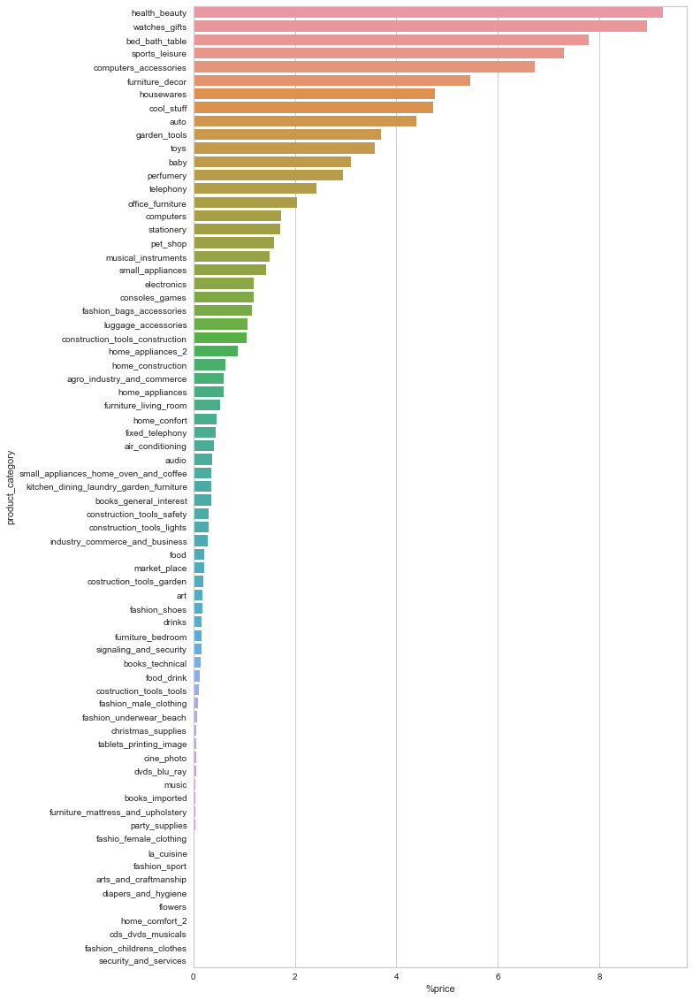

In [91]:
agg_table['product_category'] = agg_table['product_category_name_english']
agg_table.drop('product_category_name_english',axis=1,inplace=True)
category = agg_table.groupby('product_category')['price'].sum().reset_index().sort_values('price',ascending=False)
category['%price'] = (category['price']/category['price'].sum())*100
plt.figure(figsize=(10,20))
sns.barplot(y='product_category',x='%price',data=category)
plt.show()

In [92]:
category[:5]

,product_category,price,%price
43,health_beauty,1297490.77,9.259425
70,watches_gifts,1253143.30,8.942943
7,bed_bath_table,1092551.02,7.796891
65,sports_leisure,1023996.34,7.307657
15,computers_accessories,942277.57,6.724478


**Data Insight**

untuk analisis akan diambil 5 kategori terbesar karena sudah 40% pemasukan

### health_beauty

In [93]:
health_beauty = agg_table[agg_table['product_category']=='health_beauty']
health_beauty = health_beauty.groupby('customer_unique_id')['price'].sum().reset_index()
health_beauty['health_beauty'] = health_beauty['price']
health_beauty.drop('price',axis=1,inplace=True)
agg_table = agg_table.merge(health_beauty,how='left',on='customer_unique_id')
agg_table['health_beauty'].fillna(0,inplace=True)

### bed_bath_table

In [94]:
bed_bath_table= agg_table[agg_table['product_category']=='bed_bath_table']
bed_bath_table= bed_bath_table.groupby('customer_unique_id')['price'].sum().reset_index()
bed_bath_table['bed_bath_table'] = bed_bath_table['price']
bed_bath_table.drop('price',axis=1,inplace=True)
agg_table = agg_table.merge(bed_bath_table,how='left',on='customer_unique_id')
agg_table['bed_bath_table'].fillna(0,inplace=True)

### watches_gifts

In [95]:
watches_gifts= agg_table[agg_table['product_category']=='watches_gifts']
watches_gifts= watches_gifts.groupby('customer_unique_id')['price'].sum().reset_index()
watches_gifts['watches_gifts'] = watches_gifts['price']
watches_gifts.drop('price',axis=1,inplace=True)
agg_table = agg_table.merge(watches_gifts,how='left',on='customer_unique_id')
agg_table['watches_gifts'].fillna(0,inplace=True)

### sports_leisure

In [96]:
sports_leisure= agg_table[agg_table['product_category']=='sports_leisure']
sports_leisure= sports_leisure.groupby('customer_unique_id')['price'].sum().reset_index()
sports_leisure['sports_leisure'] = sports_leisure['price']
sports_leisure.drop('price',axis=1,inplace=True)
agg_table = agg_table.merge(sports_leisure,how='left',on='customer_unique_id')
agg_table['sports_leisure'].fillna(0,inplace=True)

### computers_accessories

In [97]:
computers_accessories= agg_table[agg_table['product_category']=='computers_accessories']
computers_accessories= computers_accessories.groupby('customer_unique_id')['price'].sum().reset_index()
computers_accessories['computers_accessories'] = computers_accessories['price']
computers_accessories.drop('price',axis=1,inplace=True)
agg_table = agg_table.merge(computers_accessories,how='left',on='customer_unique_id')
agg_table['computers_accessories'].fillna(0,inplace=True)

In [98]:
agg_table.groupby('cluster').agg({'health_beauty':['mean','min','max'], 
                            'watches_gifts':['mean','min','max'], 'bed_bath_table':['mean','min','max'], 
                            'sports_leisure':['mean','min','max'], 'computers_accessories':['mean','min','max'],
                            'customer_unique_id':['count']
}).reset_index()

cluster health_beauty               watches_gifts                \
                   mean  min      max          mean  min      max   
0       0     27.101169  0.0  6248.00     28.907839  0.0  4800.00   
1       1      7.118806  0.0   651.92      4.249168  0.0   350.68   
2       2     12.772207  0.0  3180.00     10.926456  0.0  3999.90   

  bed_bath_table               sports_leisure               \
            mean  min      max           mean  min     max   
0      26.281459  0.0  1999.98      20.352339  0.0  4059.0   
1       7.515264  0.0   779.94       5.608603  0.0   592.0   
2      20.373157  0.0  1740.00      14.203922  0.0  5814.0   

  computers_accessories               customer_unique_id  
                   mean  min      max              count  
0             27.267141  0.0  9520.14              33282  
1              4.598061  0.0   339.60              44256  
2             14.487395  0.0  3699.99              40066

**Risk to Churn Customer** banyak melakukan spending money di category bed_bath_table

In [99]:
agg_table[agg_table['cluster']==0]['product_category'].value_counts()

bed_bath_table               3365
furniture_decor              3030
health_beauty                2743
computers_accessories        2629
watches_gifts                2494
                             ... 
tablets_printing_image          7
la_cuisine                      5
flowers                         5
fashion_sport                   2
fashion_childrens_clothes       2
Name: product_category, Length: 68, dtype: int64

In [100]:
agg_table[agg_table['cluster']==1]['product_category'].value_counts()

health_beauty                4342
bed_bath_table               4221
sports_leisure               3314
computers_accessories        2945
housewares                   2789
                             ... 
fashion_sport                   6
cds_dvds_musicals               3
la_cuisine                      1
computers                       1
fashion_childrens_clothes       1
Name: product_category, Length: 70, dtype: int64

In [101]:
agg_table[agg_table['cluster']==2]['product_category'].value_counts()

bed_bath_table                           4237
furniture_decor                          3354
sports_leisure                           3253
health_beauty                            2890
computers_accessories                    2508
                                         ... 
flowers                                     5
small_appliances_home_oven_and_coffee       4
security_and_services                       2
arts_and_craftmanship                       1
diapers_and_hygiene                         1
Name: product_category, Length: 71, dtype: int64

**Best Customer** sering membeli produk di furniture_decor

**Average Customer** sering membeli produk di housewares

### furniture_decor

In [102]:
furniture_decor= agg_table[agg_table['product_category']=='furniture_decor']
furniture_decor= furniture_decor.groupby('customer_unique_id')['price'].sum().reset_index()
furniture_decor['furniture_decor'] = furniture_decor['price']
furniture_decor.drop('price',axis=1,inplace=True)
agg_table = agg_table.merge(furniture_decor,how='left',on='customer_unique_id')
agg_table['furniture_decor'].fillna(0,inplace=True)

### housewares

In [103]:
housewares= agg_table[agg_table['product_category']=='housewares']
housewares= housewares.groupby('customer_unique_id')['price'].sum().reset_index()
housewares['housewares'] = housewares['price']
housewares.drop('price',axis=1,inplace=True)
agg_table = agg_table.merge(housewares,how='left',on='customer_unique_id')
agg_table['housewares'].fillna(0,inplace=True)

In [104]:
agg_table.groupby('cluster').agg({'furniture_decor':['mean','min','max'],'housewares':['mean','min','max'],'customer_unique_id':['count']
}).reset_index()

cluster furniture_decor              housewares                \
                     mean  min     max       mean  min      max   
0       0       23.272805  0.0  3003.0  17.769102  0.0  2338.08   
1       1        4.270831  0.0   899.1   4.274563  0.0   532.80   
2       2       13.951180  0.0  2197.0  11.283799  0.0  6735.00   

  customer_unique_id  
               count  
0              33282  
1              44256  
2              40066

**Business Recommendation**

    1. Mengajak customer untuk membeli produk dengan 5 kategori teratas
    2. Mengajak risk to churn customer untuk membeli kembali produk dengan category cat_table
    3. Memberikan penawaran produk baru furniture_decor kepada Best Customer
    4. Mengajak Average Customer untuk membeli produk di housewares

## Geografi

In [106]:
import plotly as plt
import plotly.express as px
import json
from urllib.request import urlopen
import pandas as pd
with urlopen('https://raw.githubusercontent.com/codeforamerica/click_that_hood/master/public/data/brazil-states.geojson') as response:
 Brazil = json.load(response) # Javascrip object notation 

In [107]:
state_id_map = {}
for feature in Brazil ['features']:
    feature['id'] = feature['properties']['name']
    state_id_map[feature['properties']['sigla']] = feature['id']

In [108]:
soybean = pd.read_csv('https://raw.githubusercontent.com/nayanemaia/Dataset_Soja/main/soja%20sidra.csv')
print(soybean)

      ano            Estado  Produção  Longitude   Latitude  Unnamed: 5
0    1940          Rondônia         0 -11.474053 -62.226545         NaN
1    1950          Rondônia         1 -11.474053 -62.226545         NaN
2    1960          Rondônia         0 -11.474053 -62.226545         NaN
3    1970          Rondônia         0 -11.474053 -62.226545         NaN
4    1975          Rondônia        66 -11.474053 -62.226545         NaN
..    ...               ...       ...        ...        ...         ...
265  1980  Distrito Federal     10294 -15.858437 -47.596956         NaN
266  1985  Distrito Federal     66254 -15.858437 -47.596956         NaN
267  1995  Distrito Federal     50229 -15.858437 -47.596956         NaN
268  2006  Distrito Federal    112436 -15.858437 -47.596956         NaN
269  2017  Distrito Federal    243805 -15.858437 -47.596956         NaN

[270 rows x 6 columns]


In [114]:
key = pd.read_csv('key.csv')

In [115]:
state = state.merge(key,how='left',on='customer_state')

In [116]:
state

,customer_state,price,Estado,Longitude,Latitude
0,SP,5202955.05,São Paulo,-22.763116,-47.904600
1,RJ,1824092.67,Rio de Janeiro,-22.764100,-42.172600
2,MG,1585308.03,Minas Gerais,-18.824095,-44.034500
3,RS,750304.02,Rio Grande do Sul,-30.055067,-52.387882
4,PR,683083.76,Paraná,-24.722653,-51.095480
5,SC,520553.34,Santa Catarina,-27.257104,-49.879454
6,BA,511349.99,Bahia,-12.197327,-40.191427
7,DF,302603.94,Distrito Federal,-15.858437,-47.596956
8,GO,294591.95,Goiás,-16.852900,-51.105000
9,ES,275037.31,Espírito Santo,-19.768337,-40.356500


In [117]:
fig = px.choropleth(
 state, #soybean database
 locations = 'Estado',
 geojson = Brazil, #shape information
 color = "price", #defining the color of the scale through the database
 hover_name = 'Estado', #the information in the box
 hover_data =["price","Longitude","Latitude"],
 title = "Revenue tiap Provinsi"
)
fig.update_geos(fitbounds = "locations", visible = False)
fig.show()

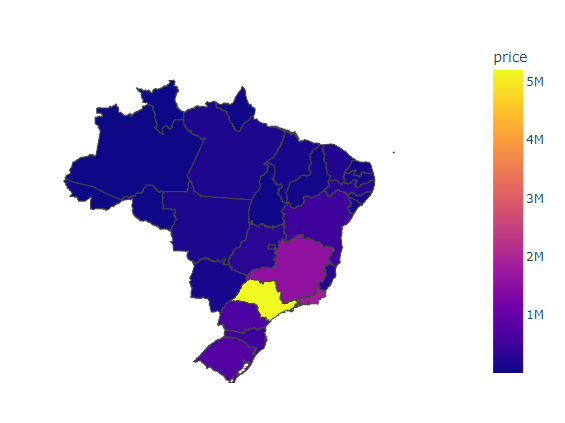

In [118]:
agg_table[agg_table['cluster']==0]['customer_state'].value_counts()[:5]

SP    13329
RJ     4498
MG     3929
RS     1825
PR     1677
Name: customer_state, dtype: int64

In [119]:
agg_table[agg_table['cluster']==1]['customer_state'].value_counts()[:5]

SP    20580
RJ     5272
MG     5035
PR     2260
RS     2233
Name: customer_state, dtype: int64

In [120]:
agg_table[agg_table['cluster']==2]['customer_state'].value_counts()[:5]

SP    15660
RJ     5557
MG     4674
RS     2428
PR     2025
Name: customer_state, dtype: int64

Customer banyak yang memiliki tempat tinggal di SP, RJ, MG dan RS

In [121]:
orders['order_delivered_customer_date'] = pd.to_datetime(orders['order_delivered_customer_date'])
orders['order_estimated_delivery_date'] = pd.to_datetime(orders['order_estimated_delivery_date'])

In [122]:
late = orders[orders['order_delivered_customer_date'] > orders['order_estimated_delivery_date']] 

In [123]:
late['late'] = 'yes'
late = late[['order_id','late']]

In [124]:
agg_table = agg_table.merge(late,how='left',on='order_id')

In [125]:
agg_table['late'] = agg_table['late'].fillna('no')

In [126]:
late_geo = agg_table[agg_table['late']=='yes']
late_geo.drop_duplicates(subset='order_id',inplace=True)

In [127]:
late_geo.shape[0]

7827

In [128]:
late_geo['customer_state'].value_counts()[:5]

SP    2387
RJ    1664
MG     638
BA     457
RS     382
Name: customer_state, dtype: int64

<AxesSubplot:xlabel='customer_state', ylabel='%late'>

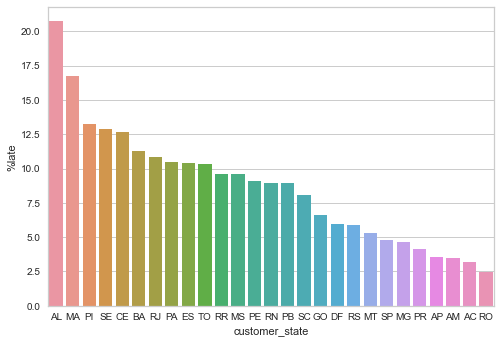

In [129]:
late_order = late_geo.groupby('customer_state')['order_id'].count().reset_index()
total_order = agg_table.groupby('customer_state')['order_id'].count().reset_index()
late_order['total_order'] = total_order['order_id']
late_order['%late'] = (late_order['order_id']/late_order['total_order'])*100
late_order = late_order.sort_values('%late',ascending=False)
sns.barplot(x='customer_state',y='%late',data=late_order)

In [130]:
late_order= late_order.merge(key,how='left',on='customer_state')

In [132]:
fig = px.choropleth(
 late_order, #soybean database
 locations = 'Estado',
 geojson = Brazil, #shape information
 color = "%late", #defining the color of the scale through the database
 hover_name = 'Estado', #the information in the box
 hover_data =["%late","Longitude","Latitude"],
 title = "%late tiap Provinsi"
)
fig.update_geos(fitbounds = "locations", visible = False)
fig.show()

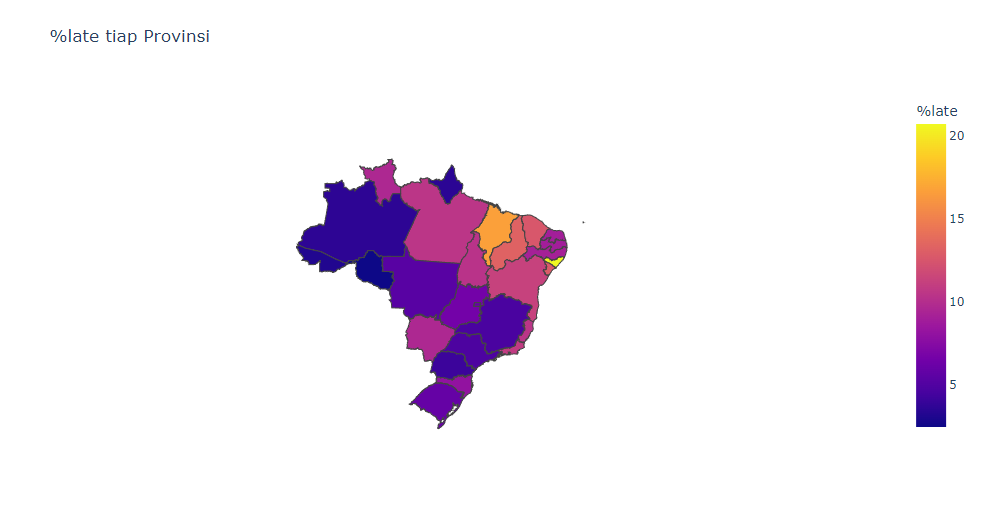

Ada 7827 order yang mengalami keterlambatan

Tim marketing dapat melakukan riset mengapa SP,RJ, MG, BA sering mengalami terlambatan

Tim marketing dapat melakukan riset mengapa Region AL,MA, PI, SE, CE,BA memiliki persentase keterlambatan >10%

Brazil bagian selatan banyak yang mengalami keterlambatan lebih dari 15%

## Payment

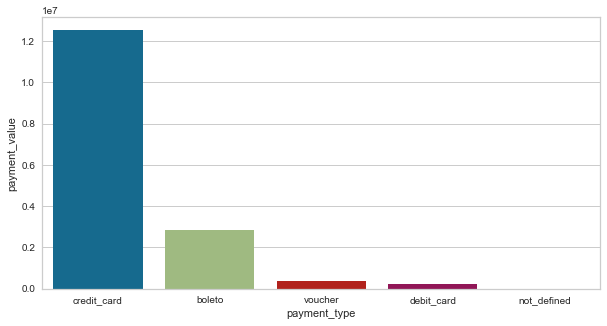

In [134]:
import matplotlib.pyplot as plt 
payment = order_payments.groupby('payment_type')['payment_value'].sum().reset_index().sort_values('payment_value',ascending=False)
plt.figure(figsize=(10,5))
sns.barplot(x='payment_type',y='payment_value',data=payment)
plt.show()

### credit_card

In [135]:
credit_card= agg_table[agg_table['payment_type']=='credit_card']
credit_card= credit_card.groupby('customer_unique_id')['price'].sum().reset_index()
credit_card['credit_card'] = credit_card['price']
credit_card.drop('price',axis=1,inplace=True)
agg_table = agg_table.merge(credit_card,how='left',on='customer_unique_id')
agg_table['credit_card'].fillna(0,inplace=True)

### boleto

In [136]:
boleto= agg_table[agg_table['payment_type']=='boleto']
boleto= boleto.groupby('customer_unique_id')['price'].sum().reset_index()
boleto['boleto'] = boleto['price']
boleto.drop('price',axis=1,inplace=True)
agg_table = agg_table.merge(boleto,how='left',on='customer_unique_id')
agg_table['boleto'].fillna(0,inplace=True)

In [137]:
agg_table.groupby('cluster').agg({'credit_card':['mean','min','max'],'boleto':['mean','min','max'],'payment_installments':['mean','min','max'],'customer_unique_id':['count']
}).reset_index()

cluster credit_card                   boleto                \
                 mean  min      max       mean  min      max   
0       0  236.162457  0.0   7798.0  55.381492  0.0  7160.00   
1       1   49.852811  0.0    280.0  11.977841  0.0   151.56   
2       2  131.389504  0.0  13440.0  31.832100  0.0  6499.00   

  payment_installments            customer_unique_id  
                  mean  min   max              count  
0             3.814584  0.0  24.0              33282  
1             2.151979  0.0  15.0              44256  
2             3.082420  1.0  20.0              40066

credit_card dan boleto banyak digunakan media pembayaran

Tim marketing dapat menawarkan strategi marketing khusus untuk pembayaran kredit untuk **Best Customer**

Tim marketing dapat memberikan strategi marketing khusus untuk pembayaran selain kredit kepada **Average Customer**